## Tabular Playground Unsupervised Clustering Challenge

In this challenge, you are given a dataset where each row belongs to a particular cluster. Your job is to predict the cluster each row belongs to. You are not given any training data, and you are not told how many clusters are found in the ground truth labels.

For this challenge, you are given (simulated) manufacturing control data that can be clustered into different control states. Your task is to cluster the data into these control states. You are not given any training data, and you are not told how many possible control states there are. This is a completely unsupervised problem, one you might encounter in a real-world setting.

#### Files
data.csv - the file includes continuous and categorical data; your task is to predict which rows should be clustered together in a control state
sample_submission.csv - a sample submission file in the correct format, where Predicted is the predicted control state

In [1]:
# Libraries Used

import numpy as np
import pandas as pd
import seaborn as sns
sns.set(style='darkgrid', font_scale=1.4)
import matplotlib.pyplot as plt
%matplotlib inline
from itertools import combinations
import math
import statistics
import scipy.stats
from scipy.stats import pearsonr
from scipy.stats import shapiro
import time
from datetime import datetime
import matplotlib.dates as mdates
import plotly.express as px
from termcolor import colored
import warnings
warnings.filterwarnings("ignore")

# Sklearn
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV, TimeSeriesSplit
from sklearn.preprocessing import StandardScaler, RobustScaler, PowerTransformer, OneHotEncoder, LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.pipeline import make_pipeline
from sklearn.compose import make_column_transformer
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, accuracy_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.mixture import GaussianMixture, BayesianGaussianMixture

# UMAP
import umap
import umap.plot

In [2]:
data = pd.read_csv('data.csv', index_col='id')
print('Dataframe Shape:', data.shape)
data.head()

Dataframe Shape: (98000, 29)


,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,f_09,...,f_19,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_27,f_28
id,,,,,,,,,,,,,,,,,,,,,
0,-0.389420,-0.912791,0.648951,0.589045,-0.830817,0.733624,2.258560,2,13,14,...,-0.478412,-0.757002,-0.763635,-1.090369,1.142641,-0.884274,1.137896,1.309073,1.463002,0.813527
1,-0.689249,-0.453954,0.654175,0.995248,-1.653020,0.863810,-0.090651,2,3,6,...,-0.428791,-0.089908,-1.784204,-0.839474,0.459685,1.759412,-0.275422,-0.852168,0.562457,-2.680541
2,0.809079,0.324568,-1.170602,-0.624491,0.105448,0.783948,1.988301,5,11,5,...,-0.413534,-1.602377,1.190984,3.267116,-0.088322,-2.168635,-0.974989,1.335763,-1.110655,-3.630723
3,-0.500923,0.229049,0.264109,0.231520,0.415012,-1.221269,0.138850,6,2,13,...,0.619283,1.287801,0.532837,1.036631,-2.041828,1.440490,-1.900191,-0.630771,-0.050641,0.238333
4,-0.671268,-1.039533,-0.270155,-1.830264,-0.290108,-1.852809,0.781898,8,7,5,...,-1.628830,-0.434948,0.322505,0.284326,-2.438365,1.473930,-1.044684,1.602686,-0.405263,-1.987263


In [3]:
print('Missing Values:', data.isna().sum().sum())

Missing Values: 0


In [4]:
print(f'Duplicates in dataset: {data.duplicated().sum()}, ({np.round(100*data.duplicated().sum()/len(data),1)}%)')

Duplicates in dataset: 0, (0.0%)


In [5]:
data.dtypes

f_00    float64
f_01    float64
f_02    float64
f_03    float64
f_04    float64
f_05    float64
f_06    float64
f_07      int64
f_08      int64
f_09      int64
f_10      int64
f_11      int64
f_12      int64
f_13      int64
f_14    float64
f_15    float64
f_16    float64
f_17    float64
f_18    float64
f_19    float64
f_20    float64
f_21    float64
f_22    float64
f_23    float64
f_24    float64
f_25    float64
f_26    float64
f_27    float64
f_28    float64
dtype: object

## EDA

There are 7 discrete features: f_07 to f_13.
Values are non-negative.
Distributions are all similar, perhaps Poisson.

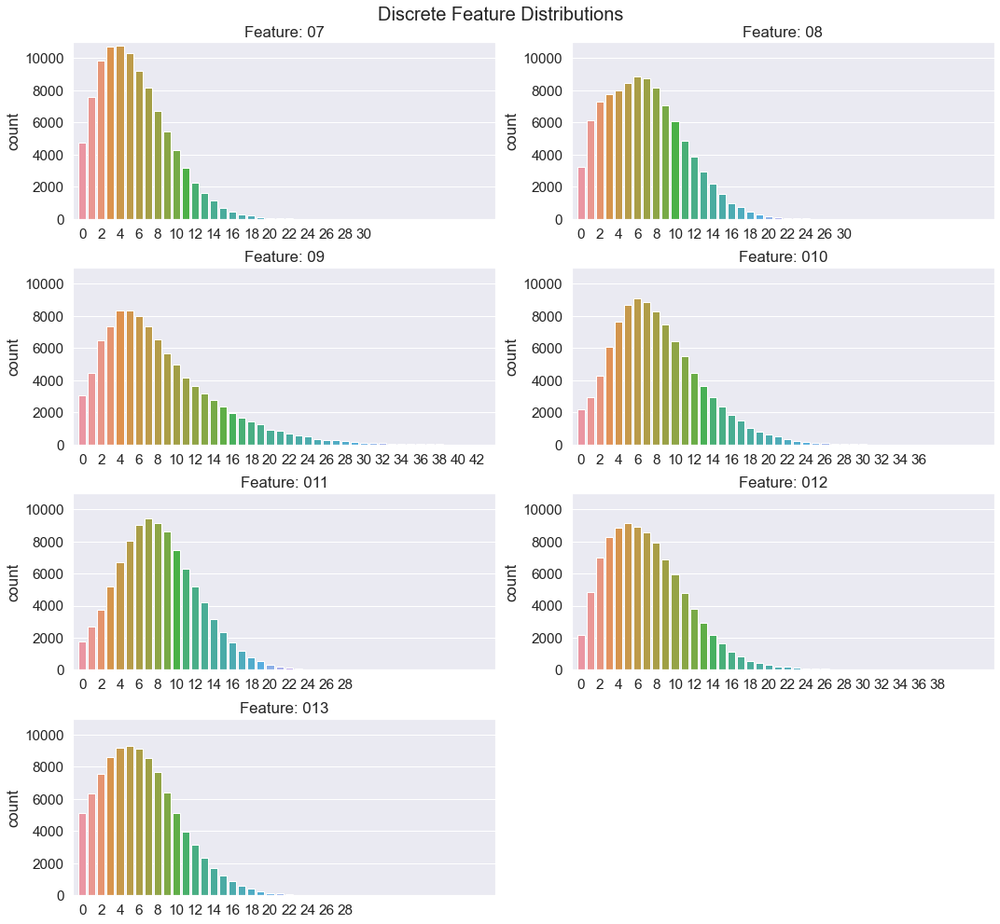

In [6]:
# Figure with subplots
fig = plt.figure(figsize=(15,14))

for i in range(7):
    # New Subplots
    plt.subplot(4,2,i+1)
    feat_num = i+7
    sns.countplot(x = data.iloc[:,feat_num])
    
    # Aesthetics
    plt.title(f'Feature: 0{feat_num}')
    plt.xlim([-1,44])      # same scale for all plots
    plt.ylim([0,11000])   # same scale for all plots
    plt.xticks(np.arange(0,44,2))
    plt.xlabel('')
    
# Overall Aesthetics
fig.suptitle('Discrete Feature Distributions',  size=20)
fig.tight_layout()  # Improves appearance a bit
plt.show()

In [7]:
# Continuous Features
# There are 22 continuous features: f_00 to f_06 and f_14 to f_28
# Distributions are all Normal, usually with mean 0 and standard deviation 1.
# Values typically lie between -5 and +5.

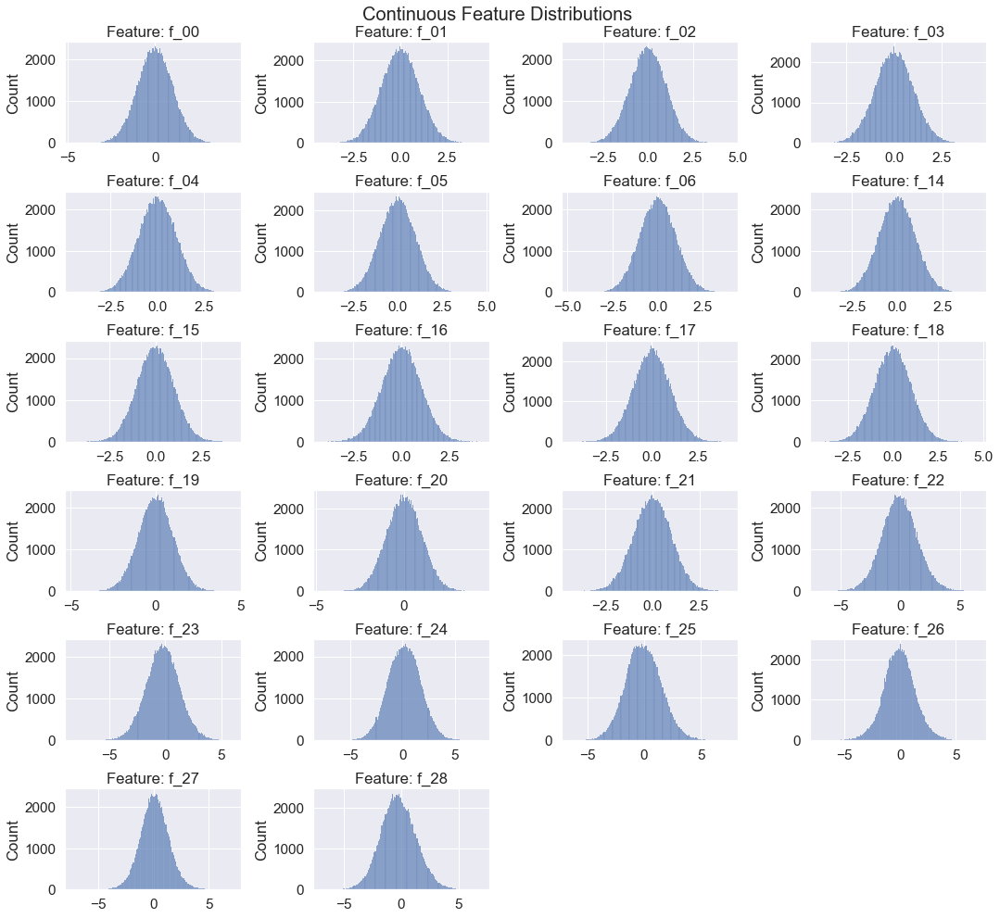

In [8]:
# Continuous features
count_features = [f'f_0{i}' for i in range(7)]
count_features = count_features + [f'f_{i}' for i in range(14,29)]

# Figure with Subplots
fig = plt.figure(figsize=(15,14))

for i, f in enumerate(count_features):
    plt.subplot(6,4,i+1)
    sns.histplot(x=data[f])
    plt.title(f'Feature: {f}')
    plt.xlabel('')
    
# Overall aesthetics
fig.suptitle('Continuous Feature Distributions',  size=20)
fig.tight_layout()  # Improves appearance a bit
plt.show()

## Hypothesis Testing

Shapiro-Wilk Test (Copied from Francisco Javier Gallego & Torch me)

This test is used to test whether a dataset is distributed normally or not. 

In [9]:
# Univariate Normality Test

for col in data.columns:
    stat, p_vale = shapiro(data[col])
    alpha = 0.05   #Significance Value
    if p_vale > alpha:
        result = colored('Accepted', 'green')
    else:
        result = colored('Rejected', 'red')
    print('Features: {}\t Hypothesis: {}'.format(col,result))

Features: f_00	 Hypothesis: Accepted
Features: f_01	 Hypothesis: Accepted
Features: f_02	 Hypothesis: Accepted
Features: f_03	 Hypothesis: Accepted
Features: f_04	 Hypothesis: Accepted
Features: f_05	 Hypothesis: Accepted
Features: f_06	 Hypothesis: Accepted
Features: f_07	 Hypothesis: Rejected
Features: f_08	 Hypothesis: Rejected
Features: f_09	 Hypothesis: Rejected
Features: f_10	 Hypothesis: Rejected
Features: f_11	 Hypothesis: Rejected
Features: f_12	 Hypothesis: Rejected
Features: f_13	 Hypothesis: Rejected
Features: f_14	 Hypothesis: Accepted
Features: f_15	 Hypothesis: Accepted
Features: f_16	 Hypothesis: Accepted
Features: f_17	 Hypothesis: Accepted
Features: f_18	 Hypothesis: Accepted
Features: f_19	 Hypothesis: Accepted
Features: f_20	 Hypothesis: Accepted
Features: f_21	 Hypothesis: Accepted
Features: f_22	 Hypothesis: Rejected
Features: f_23	 Hypothesis: Rejected
Features: f_24	 Hypothesis: Rejected
Features: f_25	 Hypothesis: Rejected
Features: f_26	 Hypothesis: Rejected
F

### Correlations

Features f_00 to f_06 and f_14 to f_21 are independent of all other features.

Discrete features (f_07 to f_13) and features f_22 to f_28 are weakly dependent of each other.

Text(0.5, 1.0, 'Absolute Correlations')

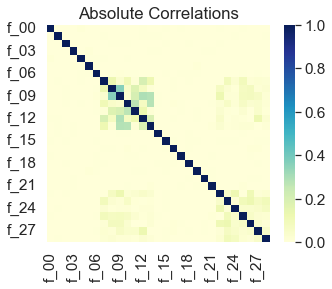

In [10]:
# Heatmap of correlations

plt.figure(figsize=(5,4))
sns.heatmap(data.corr().abs(), cmap='YlGnBu', vmin=0, vmax=1)
plt.title('Absolute Correlations')

## Elbow Method

The elbow method is a practical way to determine the number of clusters in a dataset. It works by plotting the inertia (or sometimes distortion) against the number of clusters, where inertia is defined to be the sum of squared distances of samples to their closest cluster center, i.e. a measure of the models bias. The 'elbow' (point of sudden flattening) of the curve is then chosen to be the optimal number of clusters in the dataset.

The idea is that we want low inertia (because that means we have a good model), but not too low otherwise this will lead to overfitting (since if k=number of samples then every point is a cluster and the inertia is 0). The elbow usually represents the point of diminishing returns and therefore is a good heuristic for the optimal number of clusters.

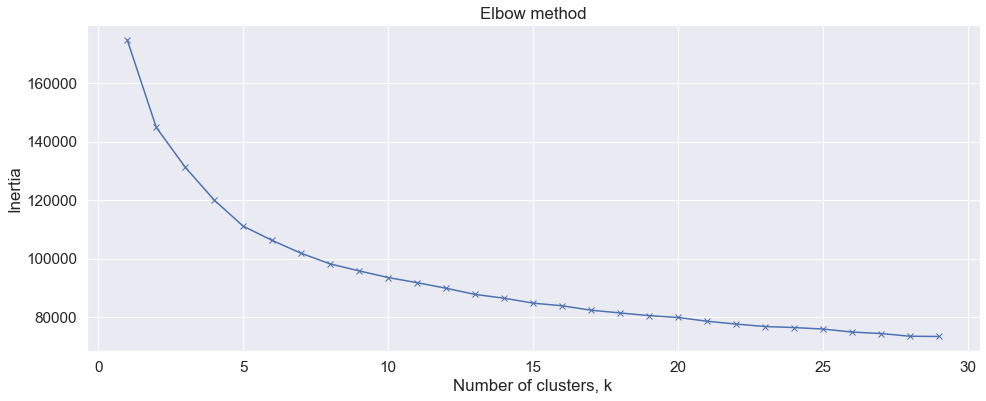

Wall time: 11.8 s


In [11]:
%%time

inertias = []
for k in range(1,30):
    km = KMeans(n_clusters=k)
    km.fit(data.iloc[:1000,:])
    inertias.append(km.inertia_)

# Plot inertias
plt.figure(figsize=(16,6))
plt.plot(range(1,30), inertias, 'bx-')
plt.xlabel('Number of clusters, k')
plt.ylabel('Inertia')
plt.title('Elbow method')
plt.show()

It is hard to tell exactly what the optimal value for the number of clusters should be since the curve is quite smooth. We will go with k=7 for now, but it might be worth experimenting with different values of k as well.

## Feature Scaling (Modelling)

It is always important to scale the data for clustering problems so that it is easier to compare the distance between data points.

There are several ways to do this, e.g.

StandardScaler: scales each column independently to have mean 0 and standard deviation 1, by subtracting by the column mean and dividing by the column standard deviation.

RobustScaler: does the same as above but uses statistics that are robust to outliers, i.e. it subtracts by the median and divides by the interquartile range.

PowerTransformer: makes columns more gaussian like by stabilising variance and minising skew.

In [12]:
#scaled_data = pd.DataFrame(StandardScaler().fit_transform(data))
#scaled_data = pd.DataFrame(RobustScaler().fit_transform(data))
scaled_data = pd.DataFrame(PowerTransformer().fit_transform(data))

scaled_data.columns = data.columns

In [13]:
scaled_data

,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,f_09,...,f_19,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_27,f_28
0,-0.389230,-0.917652,0.647948,0.590717,-0.824836,0.734685,2.259470,-0.977987,1.383372,1.039938,...,-0.472922,-0.753925,-0.763110,-0.707876,0.911477,-0.678852,0.768543,0.960344,1.042536,0.694234
1,-0.688368,-0.458647,0.653182,0.995359,-1.644030,0.864898,-0.085604,-0.977987,-0.875405,-0.179925,...,-0.423594,-0.088164,-1.777545,-0.535582,0.453824,1.031505,-0.117686,-0.550783,0.367242,-1.636652
2,0.805709,0.319397,-1.166935,-0.622421,0.108371,0.785018,1.990489,0.021718,1.017648,-0.394246,...,-0.408425,-1.598612,1.194423,2.203065,0.086974,-1.519163,-0.568662,0.978900,-0.926277,-2.296373
3,-0.500469,0.223997,0.262677,0.234061,0.417047,-1.218768,0.144455,0.286548,-1.213526,0.917564,...,0.620278,1.283827,0.532884,0.731623,-1.218086,0.826492,-1.173592,-0.395085,-0.100021,0.326682
4,-0.670427,-1.044482,-0.270854,-1.833338,-0.285955,-1.849243,0.787627,0.756900,0.187543,-0.394246,...,-1.614933,-0.432406,0.321899,0.228337,-1.482684,0.847999,-0.613935,1.164389,-0.374203,-1.160058
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97995,0.236079,1.649018,-0.688341,0.316100,-0.294857,0.330198,1.611098,0.021718,0.187543,0.191659,...,-0.285699,-0.255975,-0.972161,0.952876,0.407860,1.283842,-0.075219,-0.989846,0.166988,0.459507
97996,0.320923,0.704623,0.561468,-1.322145,-0.353335,0.183118,0.184227,-0.598123,0.622133,-1.243439,...,0.120203,1.383738,0.341845,1.158978,-0.429211,0.271421,0.783851,0.141914,0.692651,0.639735
97997,-0.249521,-0.464239,1.890043,-1.340827,0.197689,-0.557889,-0.375854,0.756900,0.622133,0.509344,...,-0.842327,-1.783844,-1.265007,-0.995900,1.450009,0.867108,0.180931,1.539188,1.178636,0.584929
97998,0.309671,2.175648,0.760608,0.438831,0.466863,0.063461,-0.329904,-1.440987,0.410491,0.653205,...,-0.007794,1.115797,1.571869,0.278189,0.512721,0.687465,-0.286145,-1.085469,-0.538491,0.129094


## K-Means

k-Means is an iterative clustering algorithm that works as follows:

1. Choose coordinates (e.g. randomly) for the locations of the k centroids.
2. Group datapoints together by finding the nearast centroid. (There will always be k goups).
3. Calculate the new centre of each centroid by taking the mean position of datapoints in each group.
4. Iterative until the centroids stop moving by a significant amount.

k-Means is popular because it is a reliable and fast algorithm. The main downside is that it assumes the clusters are spherical, which is not always the case.

In [14]:
%%time

# Baseline
model_km = KMeans(n_clusters=7, random_state=0)
preds_km = model_km.fit_predict(scaled_data)

Wall time: 9.64 s


k-Means doesn't end up doing so well on the leaderboard (it scores around ARI=0.23), so we will need more sophisticated models that allow for non-spherical clusters.

## Gaussian Mixture Model (GMM)

 Gaussian Mixture Model (GMM) is a clustering algorithm that assumes the data is made up combination/mixture of several (multivariate) Gaussian/Normal distributions. In contrast to k-Means, data points are assigned a probability of belonging to each cluster as opposed to being assigned a single cluster. These probabilities are worked out using the Expectation-Maximization (EM) algorithm, which estimates the parameters (mean & covariance matrix) of Gaussian distributions using an iterative Maximum Likelihood Estimation (MLE) method. At the end of the learning process, data points are assigned to a cluster by choosing the cluster with the highest probability out of all of them.

Note that the sklearn implementation can put restrictions on the type of covariance matrices learned. In particular, they can be tied, where all clusters have the same covariance matrix, diagonal, where all covariance matrices are diagonal, spherical, where the resulting clusters are spherical and full, where there are no restrictions on the covariance matrices.

GMM is a sophisticated model that often produces excellent results. The main downsides are that it can be slow for large datasets and that it assumes the clusters are normally distributed, which isn't always true.

In [15]:
%%time

# Baseline

model_gmm = GaussianMixture(n_components=7, random_state=0)
preds_gmm =model_gmm.fit_predict(scaled_data)

Wall time: 18.5 s


GMM performs much better than k-Means (around ARI=0.49 on public leaderboard).

We can plot the position of the center of each cluster to visualise how well each feature is able to separate the different clusters.

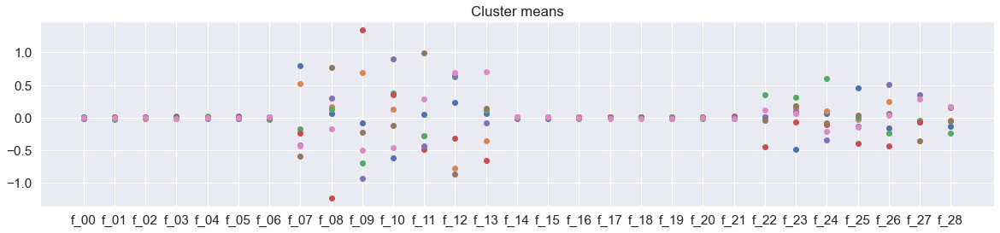

In [16]:
plt.figure(figsize=(20,4))
for i in range(model_gmm.means_.shape[0]):
    plt.scatter(np.arange(scaled_data.shape[1]), model_gmm.means_[i])
plt.xticks(ticks=np.arange(scaled_data.shape[1]), labels=scaled_data.columns)
plt.title('Cluster means')
plt.show()

From this plot we can see that the features f_00 to f_06 and f_14 to f_21 don't separate the clusters at all! This means we might as well drop these features as they are not helping us in any way.

In [17]:
%%time

# Drop useless features

drop_features = [f'f_0{i}' for i in range(7)]
drop_features = drop_features + [f'f_{i}' for i in range(14,22)]
scaled_data_crop = scaled_data.drop(drop_features, axis=1)

# Remake Predictions

model_gmm_crop = GaussianMixture(n_components=7, random_state=0)
preds_gmm_crop = model_gmm_crop.fit_predict(scaled_data_crop)

Wall time: 7.47 s


Dropping the features doesn't change the ARI score too much but it does speed up training time by a factor of about 11 seconds.

## Bayesian Gaussian Mixture Model (Bayesian GMM)

A Bayesian Gaussian Mixture Model (BGMM) is very similar to a GMM. It uses the same assumptions on the data and the same approach to finding the clusters. The only difference is in the learning algorithm. Instead of Maximum Likelihood Estimation, BGMMs use Variational Bayesian Estimation.

In [18]:
%%time

# Baseline
model_bgmm = BayesianGaussianMixture(n_components=7, covariance_type='full', max_iter=100, n_init=5, random_state=1)
preds_bgmm = model_bgmm.fit_predict(scaled_data_crop)

Wall time: 3min 26s


Bayesian GMM performs the best out of all of the models we've tried so far. It does take longer to run though.

## Visualise predictions

### Cluster distribution

Text(0.5, 1.0, 'Predicted Clusters')

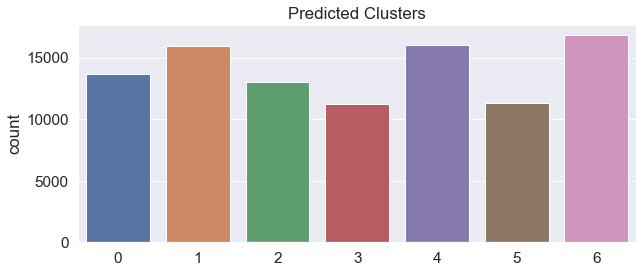

In [19]:
# Countplot
plt.figure(figsize=(10,4))
sns.countplot(x=preds_bgmm)
plt.title('Predicted Clusters')

###  Principle Component Analysis (PCA)

Principal Component Analysis (PCA) was the first dimensionality reduction technique discovered (by Karl Pearson - yes, the guy from Pearson's correlation coefficient) and dates back to as early as 1901. It is very popular because it is fast, easy to implement and easy to interpret.

PCA works by finding a low dimensional subspace that maximises the variance of the data in that subspace and performing a linear projection. This basically means the data will be as spread out as possible, without changing the relationship between the data points. This allows us to find patterns in dimensions we can visualised.

In [20]:
%%time

# PCA
pca = PCA(n_components=3)
components = pca.fit_transform(scaled_data_crop)

# 3D scatterplot
fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=preds_bgmm, size=0.1*np.ones(len(scaled_data_crop)), opacity = 1,
    title='PCA plot in 3D',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
    width=650, height=500
)
fig.show()

Wall time: 4.56 s


Explained variance shows how much of the variance/spread of the data is captured in each dimension, i.e. how important each additional principal component is to the original data representation.

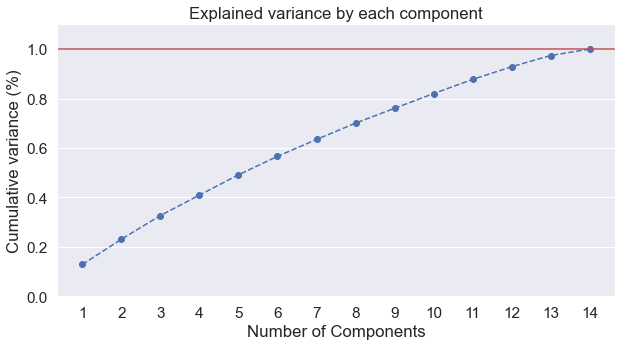

In [21]:
# PCA
pca_var = PCA()
pca_var.fit(scaled_data_crop)

# Plot
plt.figure(figsize=(10,5))
xi = np.arange(1,1+scaled_data_crop.shape[1], step=1)
yi = np.cumsum(pca_var.explained_variance_ratio_)
plt.plot(xi, yi, marker='o', linestyle='--', color='b')

# Aesthetics
plt.ylim(0.0,1.1)
plt.xlabel('Number of Components')
plt.xticks(np.arange(1,1+scaled_data_crop.shape[1], step=1))
plt.ylabel('Cumulative variance (%)')
plt.title('Explained variance by each component')
plt.axhline(y=1, color='r', linestyle='-')
plt.gca().xaxis.grid(False)

### t-SNE

t-SNE (pronounced tiz-knee) stands for t-distributed Stochastic Neighbor Embedding and was proposed much more recently by Laurens van der Maaten and Geoffrey Hinton in their 2008 paper. This works in a similar way to PCA but has some key differences:

Firstly, this is a stochastic method. So if you run multiple t-SNE plots on the same dataset it can look different.
Another difference is that this is an iterative method. It works by repeatedly moving datapoints closer or further away from each other depending on how 'similar' they are.
The new representation is non-linear. This makes it harder to interpret but it can be very effective at 'unravelling' highly non-linear data.
The main downside to t-SNE is that is very slow compared to the other dimensionality techniques. This is because it makes calculations on a pair-wise basis, which does not scale well with large datasets.

In [22]:
%%time

# PCA
tsne = TSNE(n_components=3)
components = tsne.fit_transform(scaled_data_crop.iloc[:5000,:])

# 3D scatterplot
fig = px.scatter_3d(
    components, x=0, y=1, z=2, color=preds_bgmm[:5000], size=0.1*np.ones(len(scaled_data_crop.iloc[:5000,:])), opacity = 1,
    title='t-SNE plot in 3D',
    labels={'0': 'comp. 1', '1': 'comp. 2', '2': 'comp. 3'},
    width=650, height=500
)
fig.show()

Wall time: 2min 50s


### UMAP

UMAP, which stands for Uniform Manifold Approximation and Projection was proposed by Leland McInnes, John Healy and James Melville in their 2018 paper.

It is similar to t-SNE in that it learns a non-linear mapping that preserves clusters but its main advantage is that it is significantly faster. It also tends to do better at preserving global structure of the data compared to t-SNE.

Reference: https://pair-code.github.io/understanding-umap/

In [23]:
%%time

# UMAP
um = umap.UMAP(n_components=3)
components_umap = um.fit_transform(scaled_data_crop)

# 3D scatterplot
fig = px.scatter_3d(
    components_umap, x=0, y=1, z=2, color=preds_bgmm, size=0.1*np.ones(len(scaled_data_crop)), opacity = 1,
    title='UMAP plot in 3D',
    labels={'0': 'comp. 1', '1': 'comp. 2', '2': 'comp. 3'},
    width=650, height=500
)
fig.show()

Wall time: 1min 45s


UMAP's connectivity plot is a weighted graph that gives insight into the representation of the embedding. It basically shows which connections were most important when creating the projection.

Wall time: 2min 6s


<AxesSubplot:>

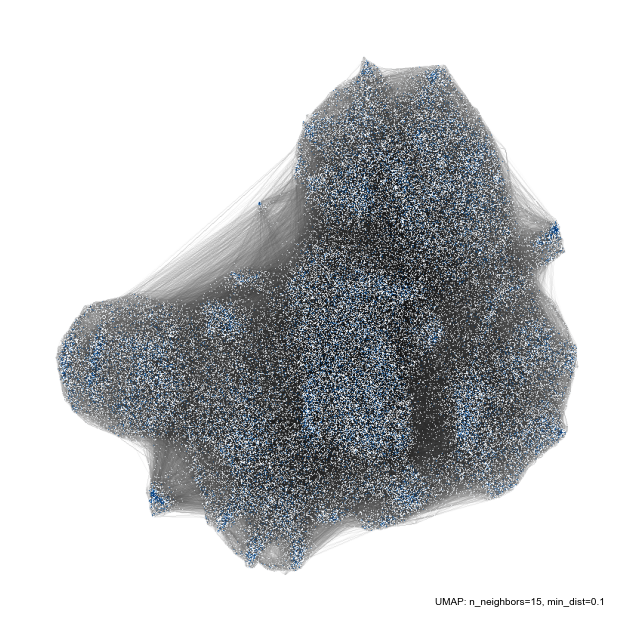

In [24]:
%%time

# Connectivity plot
um = umap.UMAP()
X_fit = um.fit(scaled_data_crop)
umap.plot.connectivity(X_fit, show_points=True)

## Submission

In [25]:
submission = pd.read_csv('sample_submission.csv')
submission['Predicted'] = preds_bgmm
submission.to_csv('submission.csv', index=False)